In [1]:
import numpy as np
import pandas as pd
import cv2
import os 
import sys
import math
import random
import matplotlib.pyplot as plt
import seaborn as sns

from tqdm import tqdm

import warnings
warnings.filterwarnings("ignore")

# Functions, classes

In [2]:
def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)


class ICVRDataset():
    def __init__(self, DATA_PATH, img_format='.jpg', annot_format='.txt', normalize_coords=True):
        self.data_path = DATA_PATH
        self.object_names = list(set([i.split('.')[0] for i in os.listdir(DATA_PATH)]))
        self.img_format = img_format
        self.annot_format = annot_format
        self.normalize_coords = normalize_coords
            
    def get_object_names(self):
        return self.object_names
    
    def __len__(self):
        return len(self.object_names)
    
    def __getitem__(self, i):
        if i not in self.object_names:
            raise "Bad object name"
            
        # prepare image
        img = cv2.imread(self.data_path + i + self.img_format)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        # prepare annotation
        annot = []
        with open(self.data_path + i + self.annot_format, 'r') as af:
            for line in af:
                line = line.strip()
                class_id = int(line[0])
                coords = list(map(float, line[2:].split(' ')))
                
                if self.normalize_coords:
                    center_x, center_y = int(coords[0] * img.shape[1]), int(coords[1] * img.shape[0])
                    w, h = (coords[2] * img.shape[1]), (coords[3] * img.shape[0])
                    coords = [center_x, center_y, w, h]
                
                annot.append({
                    'cls': class_id,
                    'crd': coords
                })
                
        return (img, annot)

# EDA

__*First view of data*__
* Type of annotation?
    - class_type  bbox_center_x  bbox_center_y  bbox_center_width  bbox_center_height
* [Number and types of classes of bboxes in annotation?](#Number-and-types-of-classes-of-bboxes-in-annotation) 
    - 0, 1, 2; 3 classes
* [Means of classes in annotation?](#Means-of-classes-in-annotation)
    - 0(jacket), 1(helmet), 2(person)
* [Number of images / annotations?](#Number-of-images-/-annotations)
    - 3222 / 3222

   
__*Histograms, plots, statistics*__

* [Image format.](#Image-formats)
    - Only jpg
* [Distribution of all classes.](#Distribution-of-all-classes)
    - '0: 7883', '1: 6515', '2: 7973'
* [How much images dont contain any person?](#How-much-images-dont-contain-any-person?)
    - 157 images
* [Statistics for number of classes for one image.](#Statistics-for-number-of-classes-for-one-image)
    - 2(0), 1(1), 2(2), more info in cell
* [Statistics for bbox sizes.](#Statistics-for-bbox-sizes)
    - More info in cell
* [Statistics for images.](#Statistics-for-images)
    - All images have 1080x1920x3 size
    
    
__*Hypotheses*__
* [Exists 0/1 classes without 2 class?](#Exists-0/1-classes-without-2-class?)
    - Yes, its anomaly because for example there are bbox for jacket but nothing for person or bbox for helmet but nothing for 3 persons on image
* [For each annotation exist image?](For-each-annotation-exist-image?)
    - Yes

In [3]:
PROJ_PATH = '/home/kirill/project/personal_projects/icvr/'
DATA_PATH = '/home/kirill/data/ICVR_dataset/dataset/'
SEED = 42

seed_everything(SEED)

## First view of data

### Number and types of classes of bboxes in annotation

In [4]:
annots = [i for i in os.listdir(DATA_PATH) if '.txt' in i]
classes = []
for annot in annots:
    annot_path = DATA_PATH + annot
    with open(annot_path, 'r') as af:
        for line in af:
            classes.append(int(line[0]))
            
print(f"All types of classes: {set(classes)}")

All types of classes: {0, 1, 2}


### Means of classes in annotation

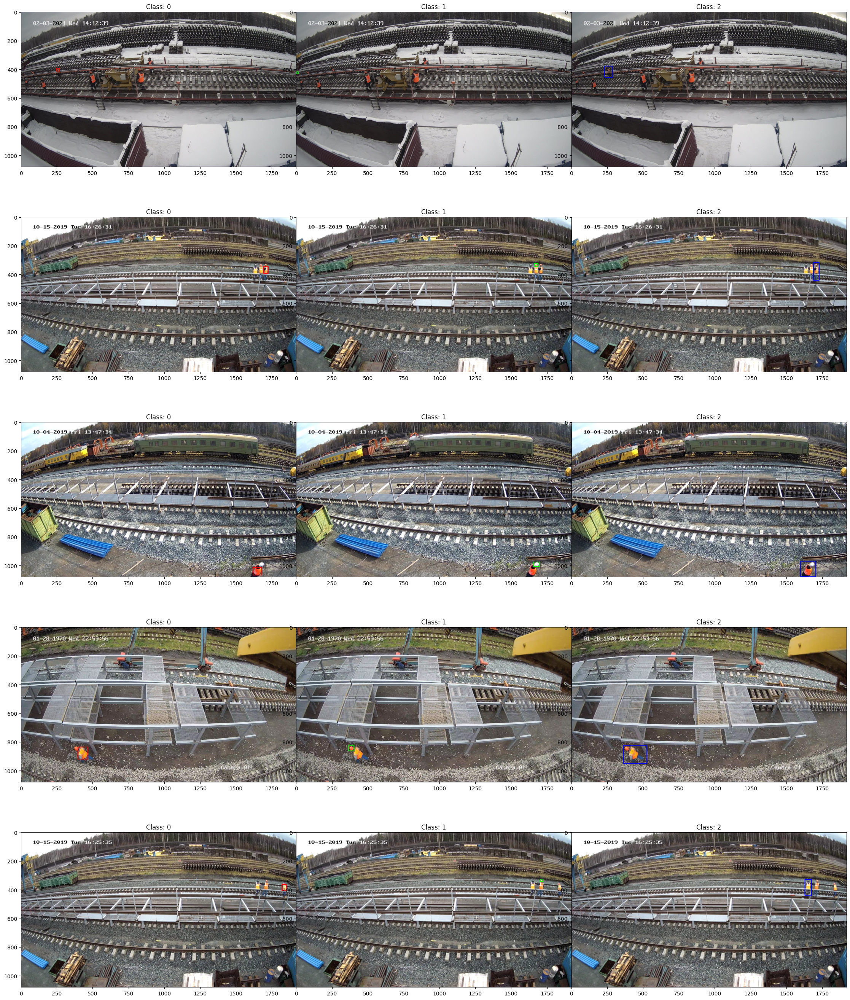

In [5]:
n = 5

rand_objects = set([i.split('.')[0] for i in os.listdir(DATA_PATH)])
rand_objects = random.sample(rand_objects, n)

_, axs = plt.subplots(nrows=n, ncols=3, figsize=(28, 7*n))


for i, o in enumerate(rand_objects):
    img_path = DATA_PATH + f'{o}.jpg'
    annot_path = DATA_PATH + f'{o}.txt'
    
    # get image and annotation
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    annot = dict()
    with open(annot_path, 'r') as af:
        for line in af:
            class_id = int(line[0])
            coords = line[1:].strip().split(' ')
            coords = list(map(float, coords))
            center_x, center_y = int(coords[0] * img.shape[1]), int(coords[1] * img.shape[0])
            w, h = int((coords[2] * img.shape[1]) / 2), int((coords[3] * img.shape[0]) / 2)
            coords = [center_x - w, center_y - h, center_x + w, center_y + h]
            annot[class_id] = coords
            
    img_0 = cv2.rectangle(img.copy(), (annot[0][0], annot[0][1]), (annot[0][2], annot[0][3]), (255, 0, 0), 4)
    img_1 = cv2.rectangle(img.copy(), (annot[1][0], annot[1][1]), (annot[1][2], annot[1][3]), (0, 255, 0), 4)
    img_2 = cv2.rectangle(img.copy(), (annot[2][0], annot[2][1]), (annot[2][2], annot[2][3]), (0, 0, 255), 4)

    axs[i][0].imshow(img_0)
    axs[i][0].set_title('Class: 0')
    axs[i][1].imshow(img_1)
    axs[i][1].set_title('Class: 1')
    axs[i][2].imshow(img_2)
    axs[i][2].set_title('Class: 2')
    
    
plt.subplots_adjust(wspace=0, hspace=0)    

### Images with annotation visuzalition

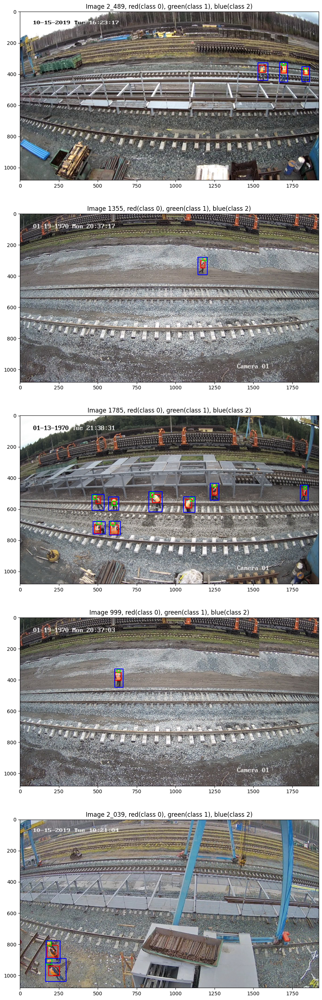

In [6]:
n = 5
dataset = ICVRDataset(DATA_PATH)
_, axs = plt.subplots(nrows=n, figsize=(28, 7*n))
rand_objects = random.sample(dataset.get_object_names(), n)

classes = []
for i, o in enumerate(rand_objects):
    item = dataset[o]
    img, annot = item[0], item[1]
    
    for a in annot:
        a_cls = a['cls']
        a_crd = a['crd']
        coords = [a_crd[0] - int(a_crd[2] / 2), a_crd[1] - int(a_crd[3] / 2), a_crd[0] + int(a_crd[2] / 2), a_crd[1] + int(a_crd[3] / 2)]
        color = [0, 0, 0]
        color[a_cls] = 255
        img = cv2.rectangle(img, (coords[0], coords[1]), (coords[2], coords[3]), color, 4)
        
    axs[i].imshow(img)
    axs[i].set_title(f"Image {o}, red(class 0), green(class 1), blue(class 2)")
         

### Number of images / annotations

In [7]:
images = [i for i in os.listdir(DATA_PATH) if '.txt' not in i]
annotations = [i for i in os.listdir(DATA_PATH) if '.txt' in i]

print(f"Number of images: {len(images)}")
print(f"Number of annotations: {len(annotations)}")

Number of images: 3222
Number of annotations: 3222


## Histograms, plots, statistics

### Image formats

In [8]:
images = [i for i in os.listdir(DATA_PATH) if '.txt' not in i]
i_formats = set([i.split('.')[1] for i in images])
print(i_formats)

{'jpg'}


### Distribution of all classes

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3222/3222 [01:25<00:00, 37.65it/s]


Counts:  ['0: 7883', '1: 6515', '2: 7973']
Number of classes


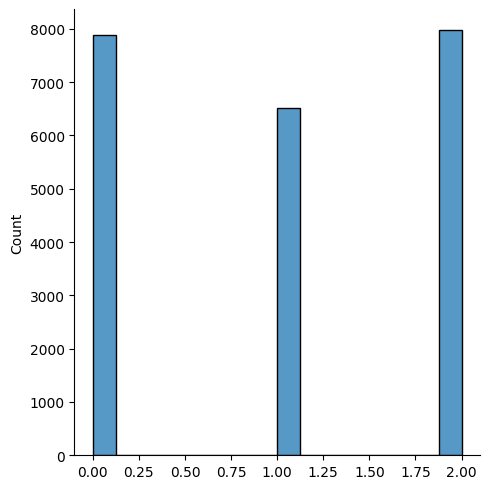

In [9]:
dataset = ICVRDataset(DATA_PATH)

classes = []
for o in tqdm(dataset.get_object_names()):
    item = dataset[o]
    img, annot = item[0], item[1]
    classes += [i['cls'] for i in annot]
    
counts = [f"{i}: {classes.count(i)}" for i in set(classes)]
print("Counts: ", counts)
print("Number of classes")
sns.displot(classes);

### How much images dont contain any person?

In [10]:
dataset = ICVRDataset(DATA_PATH)

wt_any_person = 0
for o in tqdm(dataset.get_object_names()):
    item = dataset[o]
    img, annot = item[0], item[1]
    if len(annot) == 0:
        wt_any_person += 1
        
print("Images without any person: ", wt_any_person)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3222/3222 [01:24<00:00, 38.23it/s]

Images without any person:  157


### Statistics for number of classes for one image

In [11]:
dataset = ICVRDataset(DATA_PATH)

each_image_classes = []
for o in tqdm(dataset.get_object_names()):
    item = dataset[o]
    img, annot = item[0], item[1]
    
    one_img_cls = [i['cls'] for i in annot]
    one_img_cls = [one_img_cls.count(i) for i in range(3)]
    each_image_classes.append(one_img_cls)

each_image_classes = np.array(each_image_classes)
for i in range(3):
    print("\nClass: ", i)
    print(f"Min / Max, {each_image_classes[:, i].min()} / {each_image_classes[:, i].max()}")
    print(f"Mean / Median, {each_image_classes[:, i].mean()} / {np.median(each_image_classes[:, i])}")

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3222/3222 [01:22<00:00, 38.97it/s]


Class:  0
Min / Max, 0 / 11
Mean / Median, 2.446617008069522 / 2.0

Class:  1
Min / Max, 0 / 10
Mean / Median, 2.02203600248293 / 1.0

Class:  2
Min / Max, 0 / 11
Mean / Median, 2.4745499689633768 / 2.0


### Statistics for images

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3222/3222 [01:23<00:00, 38.76it/s]


<AxesSubplot:ylabel='Count'>

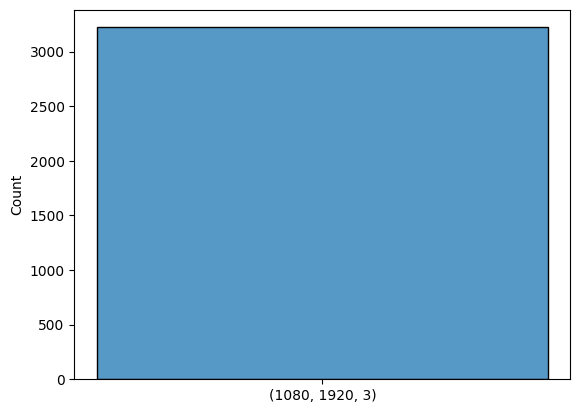

In [12]:
dataset = ICVRDataset(DATA_PATH)

img_sizes = []
for o in tqdm(dataset.get_object_names()):
    item = dataset[o]
    img, annot = item[0], item[1]
    
    img_sizes.append(f'{img.shape}')
    
sns.histplot(img_sizes)

### Statistics for bbox sizes

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3222/3222 [01:26<00:00, 37.21it/s]


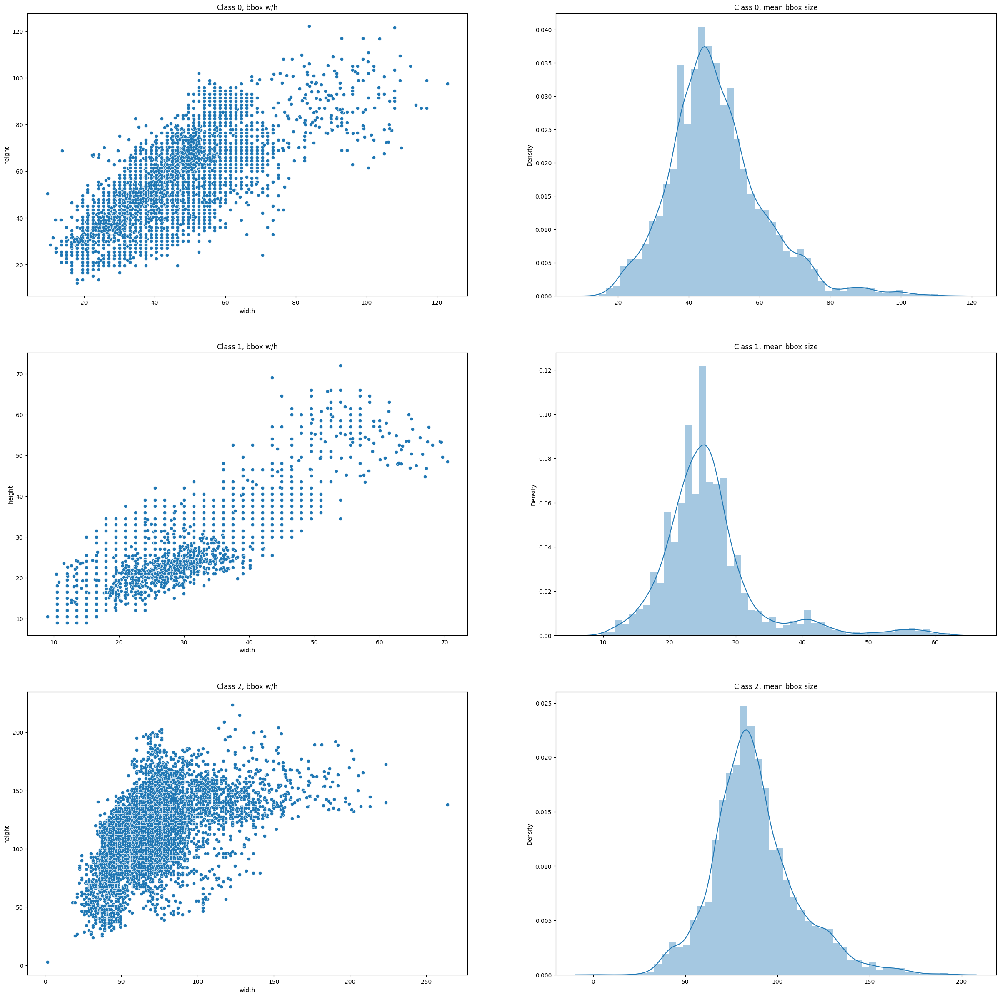

In [13]:
dataset = ICVRDataset(DATA_PATH)

bbox_sizes = {i: [] for i in range(3)}
for o in tqdm(dataset.get_object_names()):
    item = dataset[o] 
    img, annot = item[0], item[1]

    for a in annot:
        a_cls = a['cls']
        a_coords = a['crd']
        w, h = a_coords[2], a_coords[3]
        sq_size = math.sqrt(w * h)
        bbox_sizes[a_cls].append([w, h, sq_size])
        
        
_, axs = plt.subplots(ncols=2, nrows=3, figsize=(30, 30))
bbox_sizes = {k: np.array(v) for k, v in bbox_sizes.items()}
for i in range(3):
    stat = bbox_sizes[i]
    sns.scatterplot(x=stat[:, 0], y=stat[:, 1], ax=axs[i][0])
    axs[i][0].set_xlabel("width")
    axs[i][0].set_ylabel("height")
    axs[i][0].set_title(f"Class {i}, bbox w/h")
    sns.distplot(stat[:, 2], ax=axs[i][1]);
    axs[i][1].set_title(f"Class {i}, mean bbox size")
    
plt.show()

## Hypotheses

### Exists 0/1 classes without 2 class?

In [14]:
dataset = ICVRDataset(DATA_PATH)

equip_without_person = 0
anomaly_obj_names = []
for o in tqdm(dataset.get_object_names()):
    item = dataset[o]
    img, annot = item[0], item[1]
    
    clss = [i['cls'] for i in annot]
    if len(annot) != 0 and 2 not in clss:
        equip_without_person += 1
        anomaly_obj_names.append(o)
            
print(f"Anomaly cases - equip(0, 1 classes) without person(class 2), number of cases: {equip_without_person}")
print(f"Anomaly objects: {anomaly_obj_names}")

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3222/3222 [01:27<00:00, 36.88it/s]

Anomaly cases - equip(0, 1 classes) without person(class 2), number of cases: 24
Anomaly objects: ['16_0000043', '9_0000008', '2_070', '16_0000045', '9_0000011', '2_063', '000074', '16_0000057', '2_068', '16_0000044', '2_066', '2_069', '9_0000013', '16_0000056', '9_0000017', '2_067', '2_064', '9_0000014', '16_0000048', '16_0000037', '9_0000012', '2_065', '9_0000016', '16_0000059']


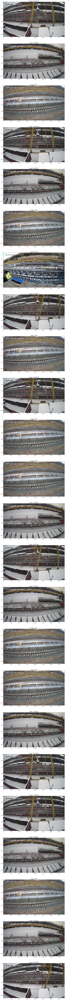

In [15]:
# visualize anomaly cases

_, axs = plt.subplots(nrows=len(anomaly_obj_names), figsize=(18, 9*len(anomaly_obj_names)))

for i, anomaly in enumerate(anomaly_obj_names):
    img, annot = dataset[anomaly]
    for a in annot:
        color = [0, 0, 0]
        color[a['cls']] = 255
        coords = [a['crd'][0] - int(a['crd'][2] / 2), a['crd'][1] - int(a['crd'][3] / 2), a['crd'][0] + int(a['crd'][2] / 2), a['crd'][1] + int(a['crd'][3] / 2)]
        img = cv2.rectangle(img, (coords[0], coords[1]), (coords[2], coords[3]), color, 3)
        
    axs[i].imshow(img)
    axs[i].set_title(f"Image: {anomaly}")

### For each annotation exist image? 

In [16]:
images = set([i.split('.')[0] for i in os.listdir(DATA_PATH) if '.txt' not in i])
annots = set([i.split('.')[0] for i in os.listdir(DATA_PATH) if '.txt' in i])

print(f"For each image exist annotation? {images == annots}")
images.difference(annots)

For each image exist annotation? True


set()